In [2]:
import math
import mldatasets
import numpy as np
import pandas as pd
from sklearn import preprocessing, metrics
import tensorflow as tf
from tensorflow import keras
import matplotlib.pyplot as plt
from matplotlib import cm
import seaborn as sns
import cv2
from keras.utils.data_utils import get_file
#PART 1 only
from tf_explain.core.activations import ExtractActivations
from tf_keras_vis.activation_maximization import ActivationMaximization
from tf_keras_vis.saliency import Saliency
from tf_keras_vis.utils import normalize
from tf_keras_vis.gradcam import GradcamPlusPlus
from tf_explain.core.integrated_gradients import IntegratedGradients
#PART 2 only
from skimage.segmentation import mark_boundaries
from tf_explain.core.occlusion_sensitivity import OcclusionSensitivity
import lime
from lime import lime_image
from alibi.explainers import CEM
import shap

In [2]:
print(tf.__version__)

2.2.0


In [3]:
X_train, X_test, X_val, X_val_orig, y_train, y_test, y_val, y_val_orig =\
                                    mldatasets.load("fruits-360", prepare=True)

https://github.com/PacktPublishing/Interpretable-Machine-Learning-with-Python/raw/master/datasets/fruits-360_abbrev.zip downloaded to /Users/serg/EXTEND/PROJECTS/InterpretableMLBook/programming/Chapter8/data/fruits-360_abbrev.zip
/Users/serg/EXTEND/PROJECTS/InterpretableMLBook/programming/Chapter8/data/fruits-360_abbrev.zip uncompressed to /Users/serg/EXTEND/PROJECTS/InterpretableMLBook/programming/Chapter8/data/fruits-360_abbrev
10633 dataset files found in /Users/serg/EXTEND/PROJECTS/InterpretableMLBook/programming/Chapter8/data/fruits-360_abbrev folder


In [4]:
X_train = X_train.astype('float32')/255
X_test = X_test.astype('float32')/255
X_val = X_val.astype('float32')/255

In [20]:
ohe = preprocessing.OneHotEncoder(sparse=False)
ohe.fit(y_train)
fruits_l = ohe.categories_[0].tolist()
print(fruits_l)

['Apple Golden', 'Apple Granny Smith', 'Apple Red', 'Avocado', 'Banana', 'Clementine', 'Grapefruit Pink', 'Mango Red', 'Nectarine', 'Onion Red', 'Onion White', 'Orange', 'Peach', 'Pear', 'Pomegranate', 'Tomato']


In [108]:
rand = 9
np.random.seed(rand)
tf.random.set_seed(rand)

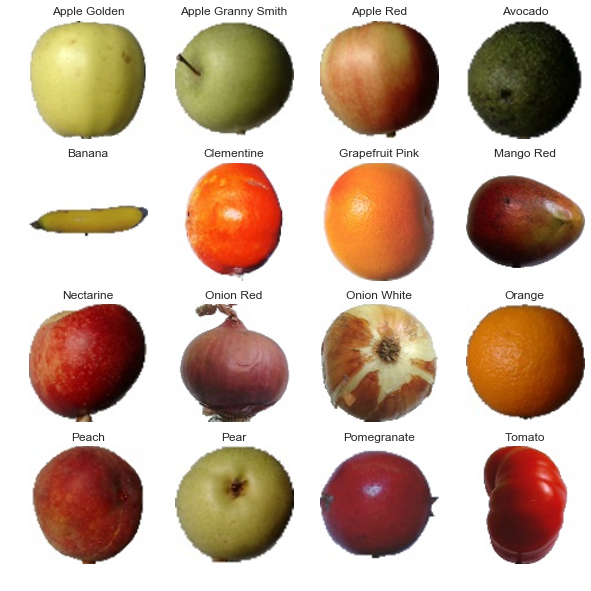

In [72]:
plt.subplots(figsize=(10,10))
for f, fruit in zip([*range(len(fruits_l))], fruits_l):
    plt.subplot(4, 4, f+1)
    plt.title(fruits_l[f], fontsize=12)
    idx = np.random.choice(np.where(y_test[:,0] == fruit)[0], 1)[0]
    plt.imshow(X_test[idx], interpolation='spline16')
    plt.axis("off")
plt.show()

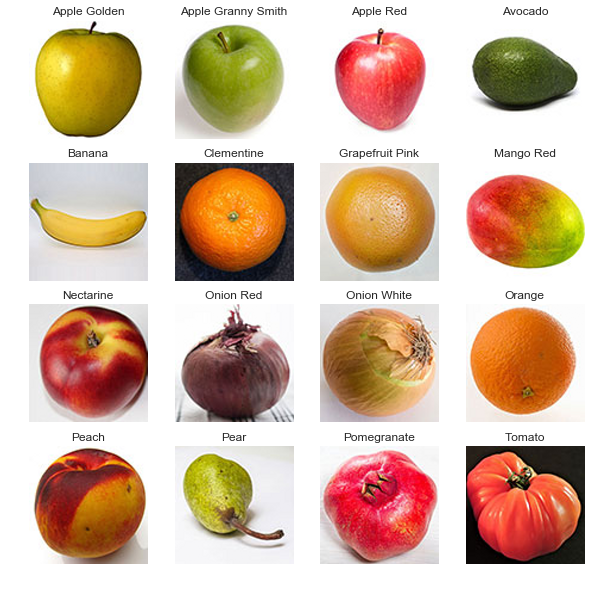

In [74]:
plt.subplots(figsize=(10,10))
for f, fruit in zip([*range(len(fruits_l))], fruits_l):
    plt.subplot(4, 4, f+1)
    plt.title(fruits_l[f], fontsize=12)
    idx = np.random.choice(np.where(y_val[:,0] == fruit)[0], 1)[0]
    plt.imshow(X_val[idx], interpolation='spline16')
    plt.axis("off")
plt.show()

In [3]:
model_path = get_file('CNN_fruits_final.hdf5',\
            'https://github.com/PacktPublishing/Interpretable-Machine-Learning-with-Python/blob/master/models/CNN_fruits_final.hdf5?raw=true')
cnn_fruits_mdl = keras.models.load_model(model_path)
cnn_fruits_mdl.summary()

4268032/4267608 [==============================] - 3s 1us/step
Model: "CNN_fruits"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_1 (Conv2D)            (None, 99, 99, 16)        208       
_________________________________________________________________
maxpool2d_1 (MaxPooling2D)   (None, 49, 49, 16)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 48, 48, 32)        2080      
_________________________________________________________________
maxpool2d_2 (MaxPooling2D)   (None, 24, 24, 32)        0         
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 23, 23, 64)        8256      
_________________________________________________________________
maxpool2d_3 (MaxPooling2D)   (None, 11, 11, 64)        0         
___________________________________________________________

In [17]:
train_score = cnn_fruits_mdl.evaluate(X_train, ohe.transform(y_train),\
                                     verbose=0)
test_score = cnn_fruits_mdl.evaluate(X_test, ohe.transform(y_test),\
                                     verbose=0)
val_score = cnn_fruits_mdl.evaluate(X_val, ohe.transform(y_val),\
                                     verbose=0)
print('Train accuracy:\t{:.1%}'.format(train_score[1]))
print('Test accuracy:\t{:.1%}'.format(test_score[1]))
print('Val accuracy:\t{:.1%}'.format(val_score[1]))

Train accuracy:	100.0%
Test accuracy:	99.9%
Val accuracy:	31.2%


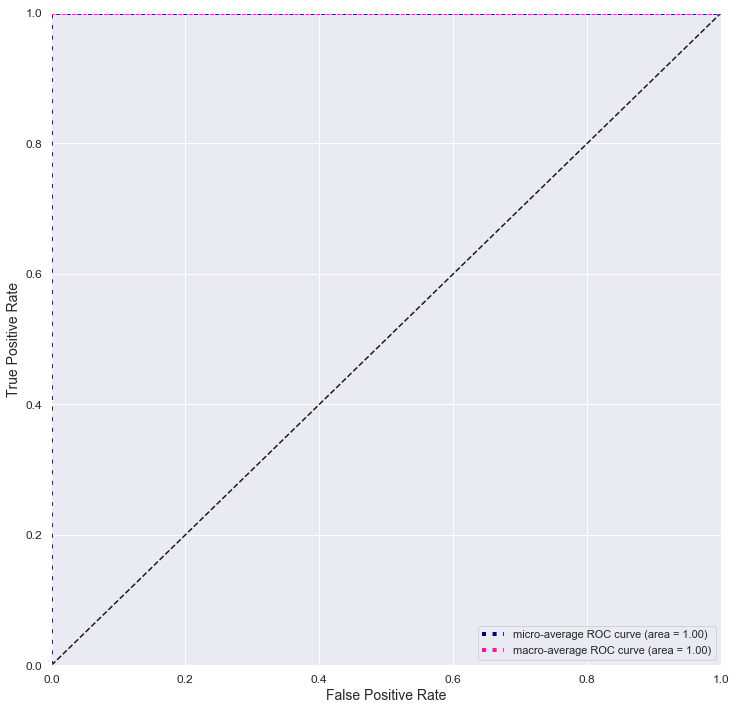

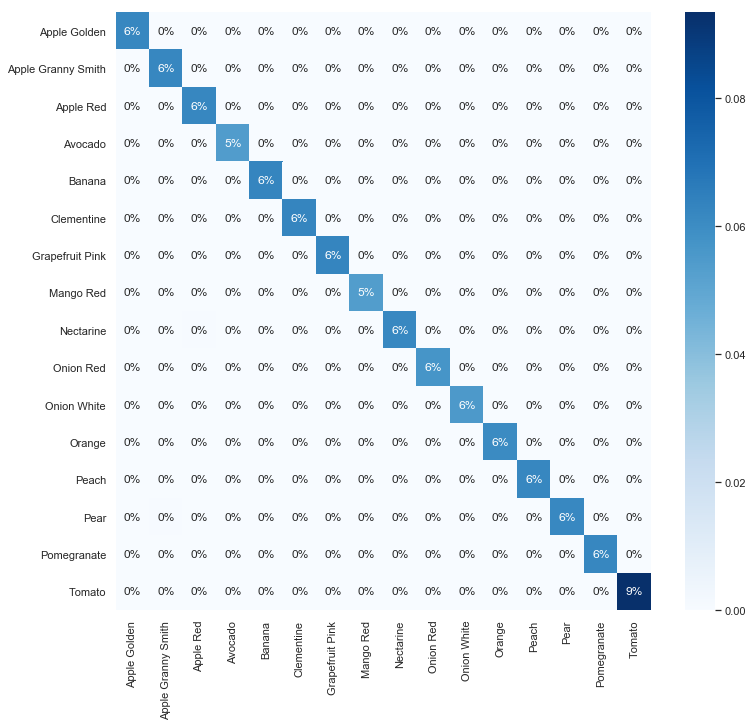

                    precision    recall  f1-score   support

      Apple Golden      1.000     1.000     1.000       164
Apple Granny Smith      0.994     1.000     0.997       164
         Apple Red      0.994     1.000     0.997       164
           Avocado      1.000     1.000     1.000       143
            Banana      1.000     1.000     1.000       166
        Clementine      1.000     1.000     1.000       166
   Grapefruit Pink      1.000     1.000     1.000       166
         Mango Red      1.000     1.000     1.000       142
         Nectarine      1.000     0.994     0.997       164
         Onion Red      1.000     1.000     1.000       150
       Onion White      1.000     1.000     1.000       146
            Orange      1.000     1.000     1.000       160
             Peach      1.000     1.000     1.000       164
              Pear      1.000     0.994     0.997       164
       Pomegranate      1.000     1.000     1.000       164
            Tomato      1.000     1.000

In [8]:
orig_plt_params = plt.rcParams
sns.set()
y_test_pred, y_test_prob =\
            mldatasets.evaluate_multiclass_mdl(cnn_fruits_mdl, X_test, y_test,\
                            fruits_l, ohe, plot_roc=True, plot_roc_class=False)

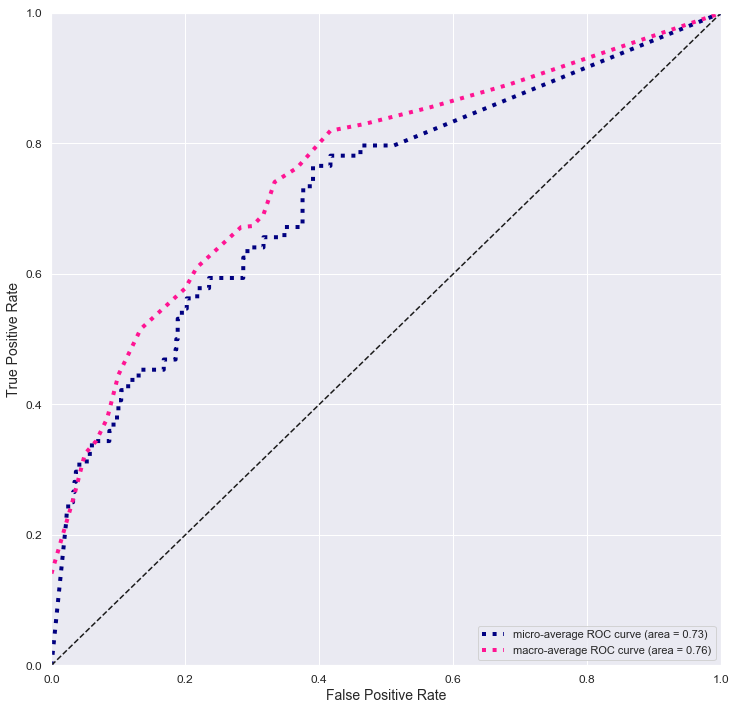

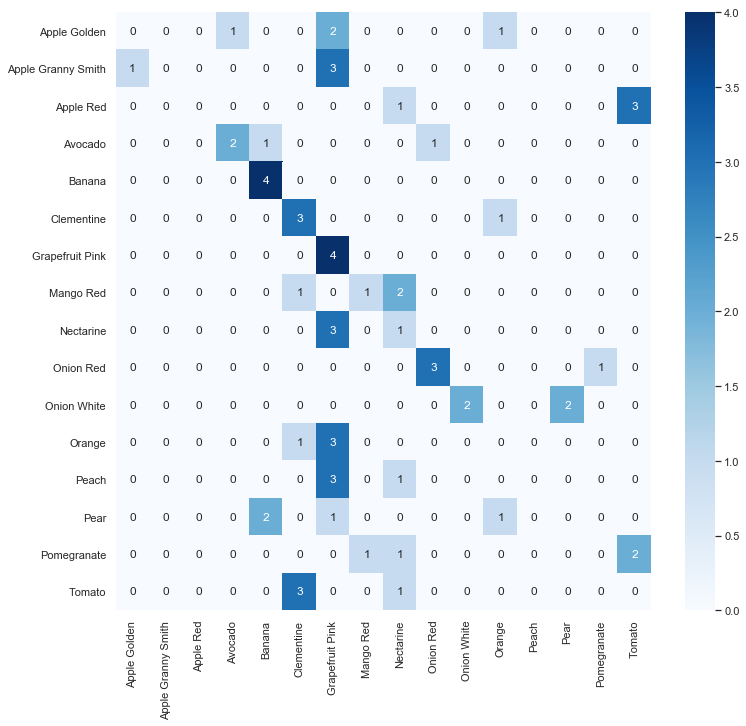

                    precision    recall  f1-score   support

      Apple Golden      0.000     0.000     0.000         4
Apple Granny Smith      0.000     0.000     0.000         4
         Apple Red      0.000     0.000     0.000         4
           Avocado      0.667     0.500     0.571         4
            Banana      0.571     1.000     0.727         4
        Clementine      0.375     0.750     0.500         4
   Grapefruit Pink      0.211     1.000     0.348         4
         Mango Red      0.500     0.250     0.333         4
         Nectarine      0.143     0.250     0.182         4
         Onion Red      0.750     0.750     0.750         4
       Onion White      1.000     0.500     0.667         4
            Orange      0.000     0.000     0.000         4
             Peach      0.000     0.000     0.000         4
              Pear      0.000     0.000     0.000         4
       Pomegranate      0.000     0.000     0.000         4
            Tomato      0.000     0.000

In [9]:
y_val_pred, y_val_prob =\
            mldatasets.evaluate_multiclass_mdl(cnn_fruits_mdl, X_val, y_val, fruits_l,\
                                    ohe, plot_roc=True, plot_roc_class=False,\
                                    pct_matrix=False)

In [10]:
preds_df = pd.DataFrame({'y_true':y_val[:,0], 'y_pred':y_val_pred})

probs_df = pd.DataFrame(y_val_prob*100).round(1)
probs_df.loc['Total']= probs_df.sum().round(1)
probs_df.columns = fruits_l
probs_df = probs_df.sort_values('Total', axis=1, ascending=False)
probs_df.drop(['Total'], axis=0, inplace=True)
probs_final_df = probs_df.iloc[:,0:8]

preds_probs_df = pd.concat([preds_df, probs_final_df], axis=1)
pd.set_option('precision', 1)
preds_probs_df.style.apply(lambda x: ['background: lightgreen' if (x[0] == x[1])\
                     else '' for i in x], axis=1).\
    apply(lambda x: ['background: orange' if (x[0] != x[1] and x[1] == 'Grapefruit Pink')\
                     else '' for i in x], axis=1).\
    apply(lambda x: ['background: yellow' if (x[0] != x[1] and x[0] == 'Avocado')\
                     else '' for i in x], axis=1).\
    apply(lambda x: ['font-weight: bold' if isinstance(i, float) and i >= 50\
                     else '' for i in x], axis=1).\
    apply(lambda x: ['color:transparent' if i == 0.0\
                     else '' for i in x], axis=1)

,y_true,y_pred,Grapefruit Pink,Clementine,Banana,Nectarine,Tomato,Onion Red,Avocado,Orange
0,Pear,Banana,0.0,0.0,100.0,0.0,0.0,0.0,0.0,0.0
1,Pear,Banana,0.0,0.0,100.0,0.0,0.0,0.0,0.0,0.0
2,Pear,Orange,5.2,0.0,0.0,0.0,0.0,0.0,0.0,94.8
3,Pear,Grapefruit Pink,96.5,0.0,3.5,0.0,0.0,0.0,0.0,0.0
4,Avocado,Onion Red,0.0,0.0,0.0,0.0,0.0,100.0,0.0,0.0
5,Avocado,Avocado,0.0,0.0,0.0,0.0,0.0,0.1,99.9,0.0
6,Avocado,Banana,0.0,0.0,100.0,0.0,0.0,0.0,0.0,0.0
7,Avocado,Avocado,0.0,0.0,0.0,0.0,0.0,0.0,100.0,0.0
8,Pomegranate,Tomato,0.0,0.0,0.0,0.0,100.0,0.0,0.0,0.0
9,Pomegranate,Tomato,0.0,0.0,0.0,0.0,100.0,0.0,0.0,0.0


In [11]:
avocado_FN_idxs = preds_df[(preds_df['y_true'] != preds_df['y_pred']) &\
                           (preds_df['y_true'] == 'Avocado')].index.to_list()
avocado_TP_idxs = preds_df[(preds_df['y_true'] == preds_df['y_pred']) &\
                           (preds_df['y_true'] == 'Avocado')].index.to_list()
grapefruit_FP_idxs = preds_df[(preds_df['y_true'] != preds_df['y_pred']) &\
                              (preds_df['y_pred'] == 'Grapefruit Pink')].index.to_list()
grapefruit_TP_idxs = preds_df[(preds_df['y_true'] == preds_df['y_pred']) &\
                              (preds_df['y_pred'] == 'Grapefruit Pink')].index.to_list()

In [439]:
target_layers = ['conv2d_1', 'conv2d_2', 'conv2d_3', 'conv2d_4']
explainer = ExtractActivations()

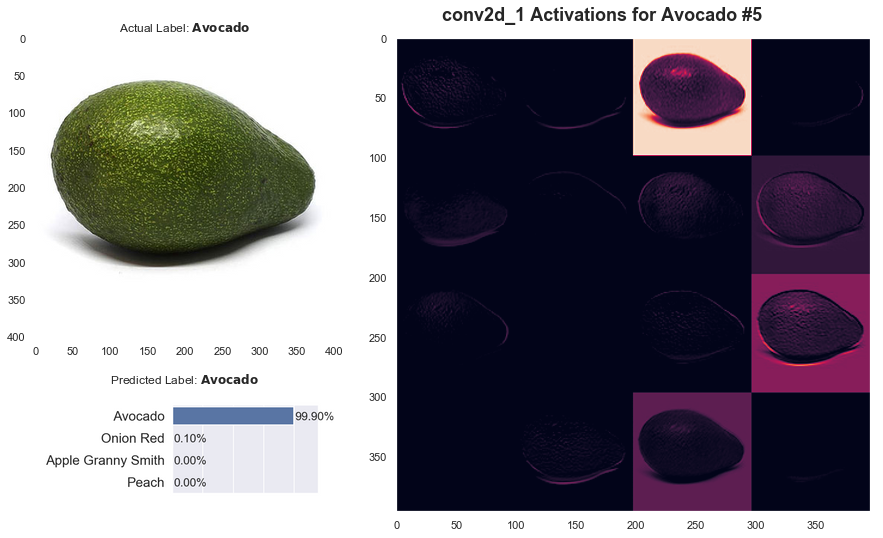

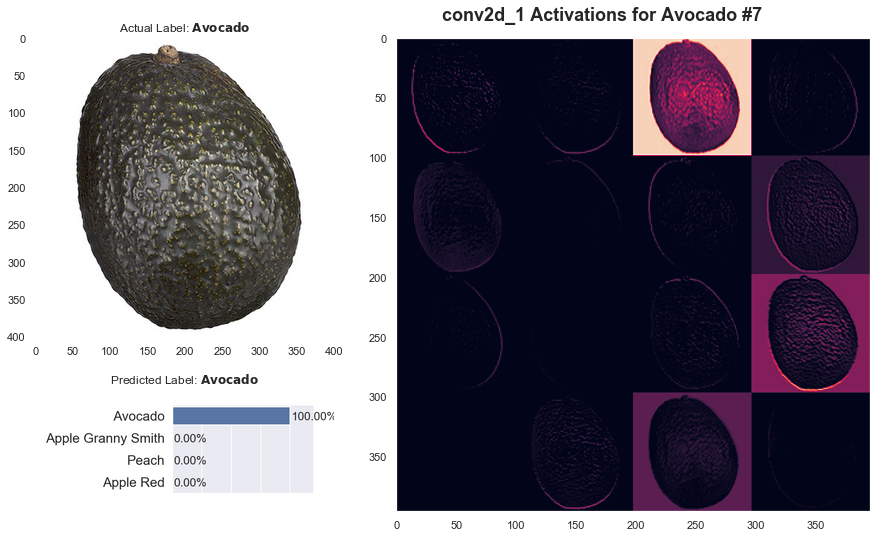

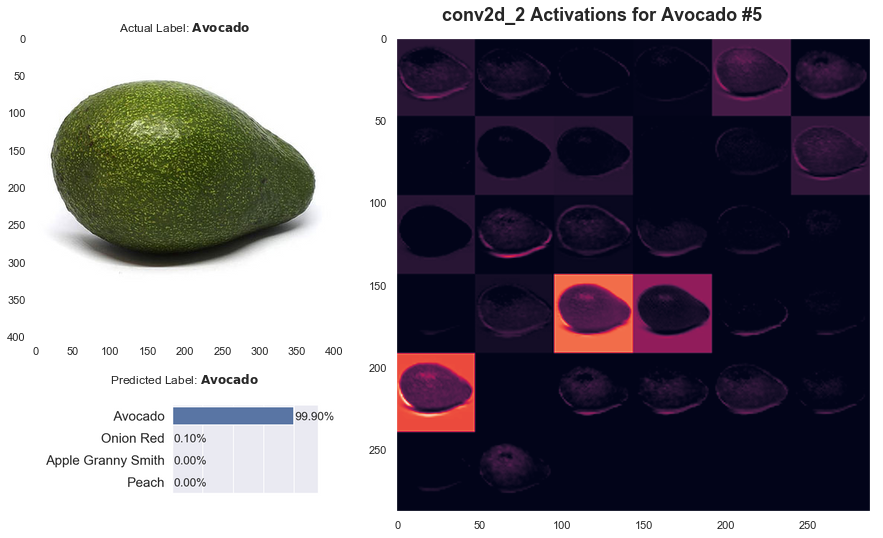

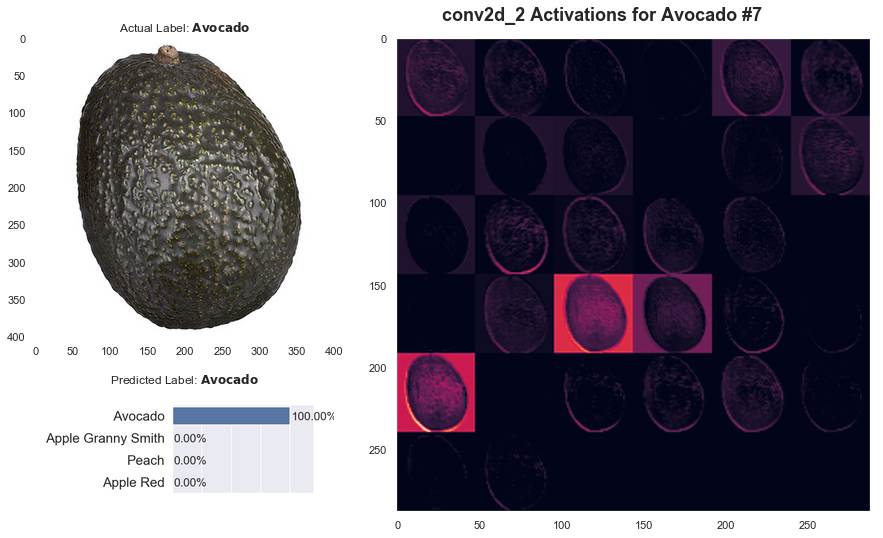

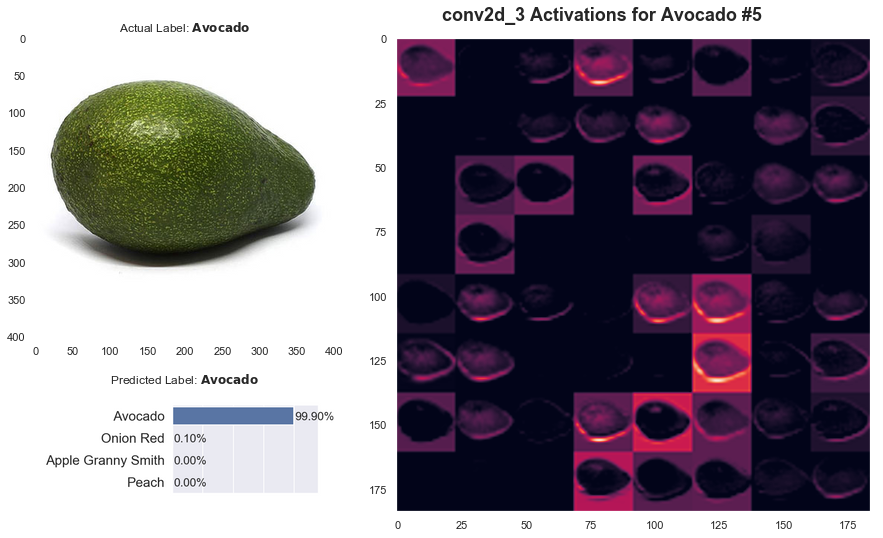

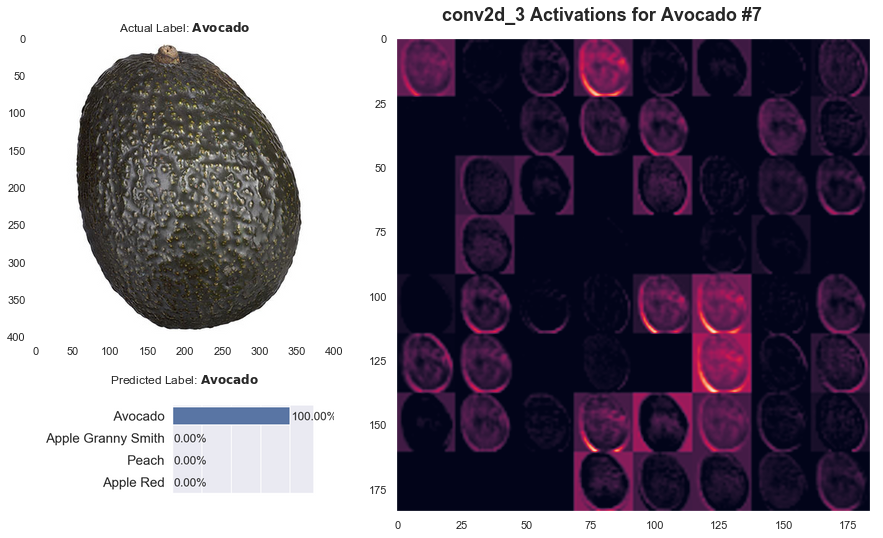

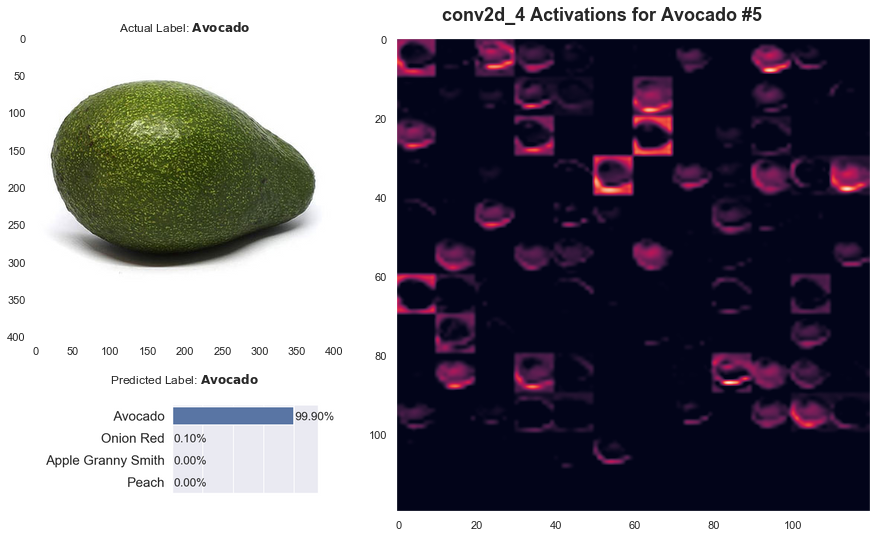

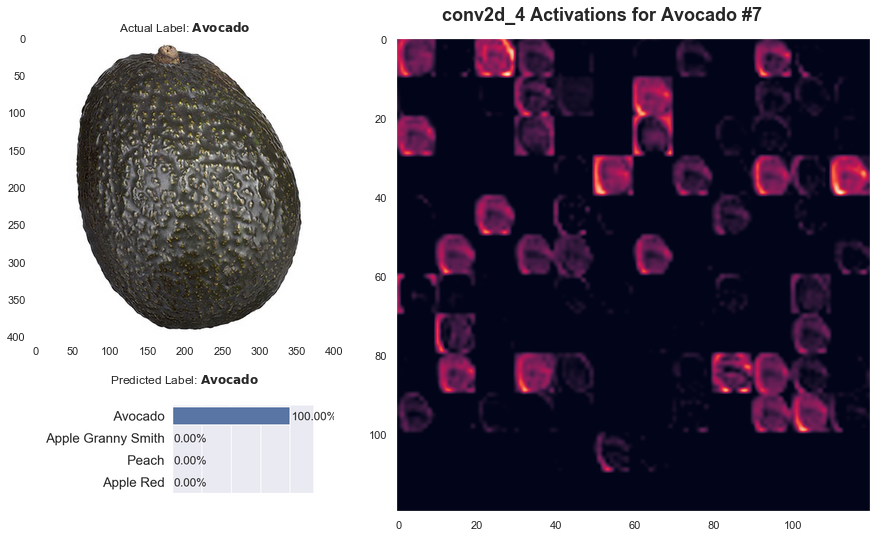

In [15]:
for target_layer in target_layers:
    for idx in avocado_TP_idxs:
        orig_img = X_val_orig[idx]
        viz_img = explainer.explain((np.array([X_val[idx]]), None),\
                                    cnn_fruits_mdl, target_layer)
        y_true = y_val[idx,0]
        y_pred = y_val_pred[idx]
        probs_s = probs_df.loc[idx]
        title = '{} Activations for Avocado #{}'.format(target_layer, idx)
        mldatasets.compare_img_pred_viz(orig_img, viz_img, y_true,\
                                        y_pred, probs_s, title=title)

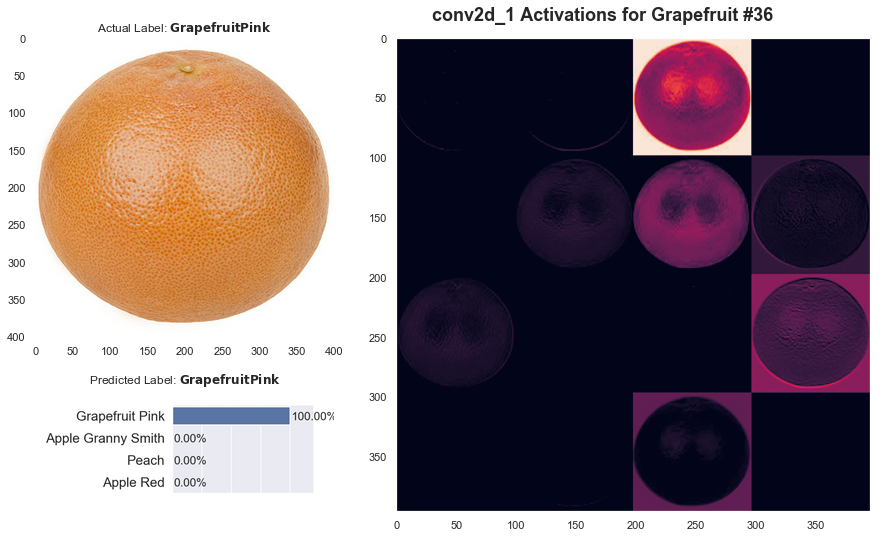

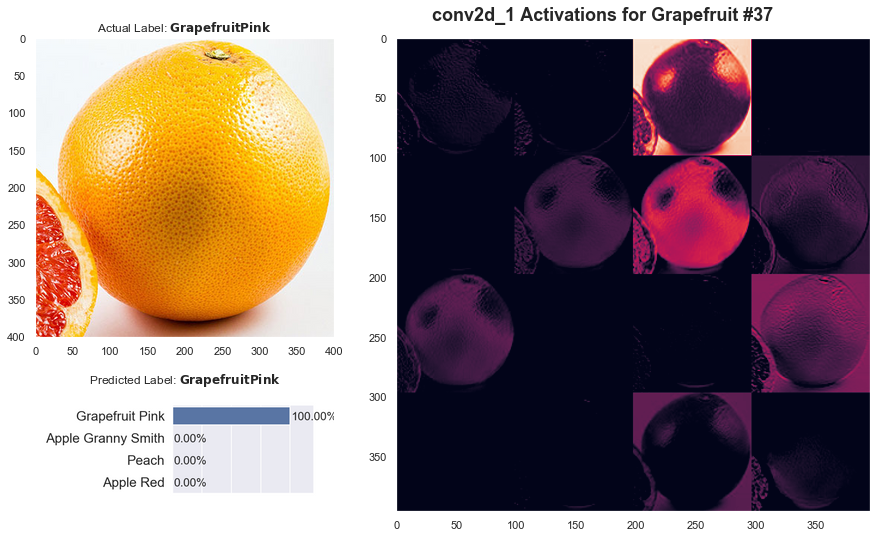

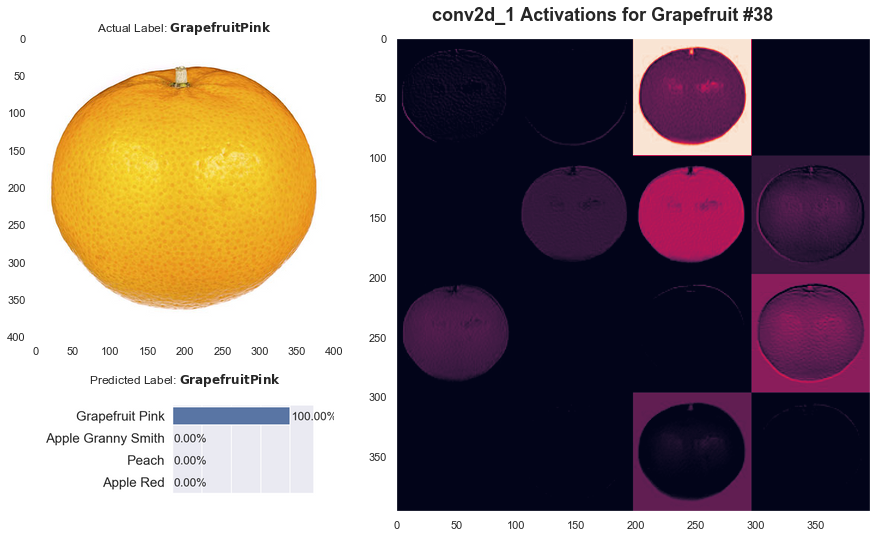

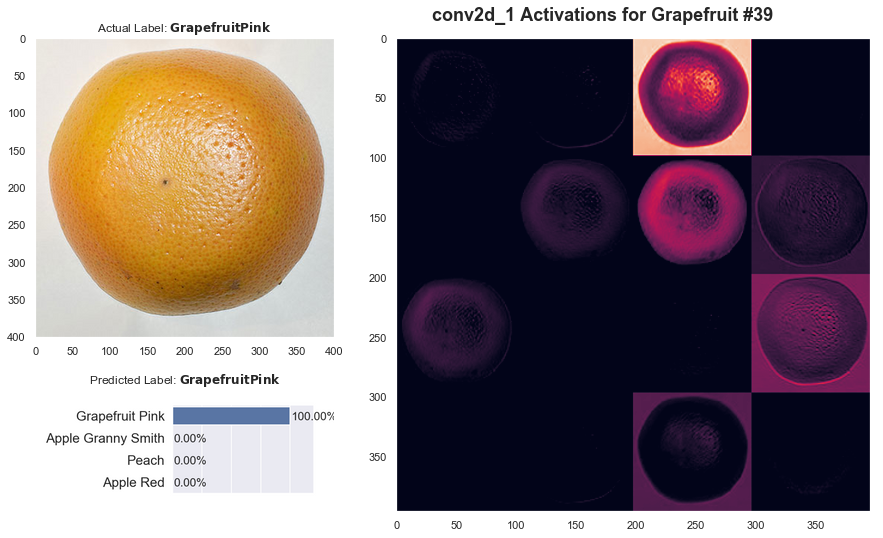

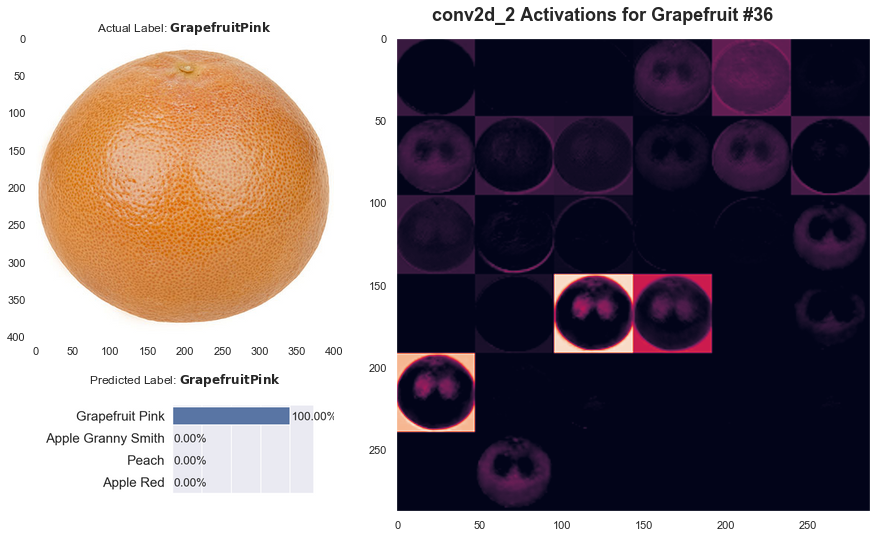

...

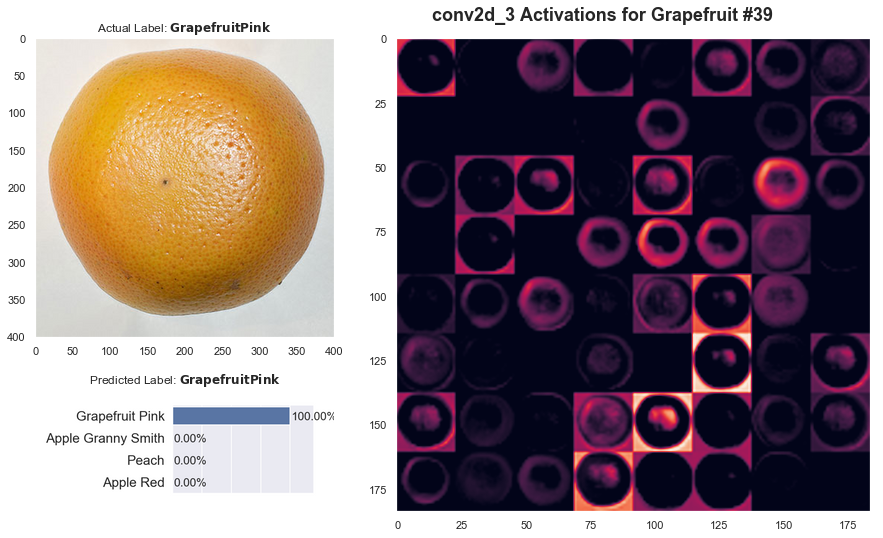

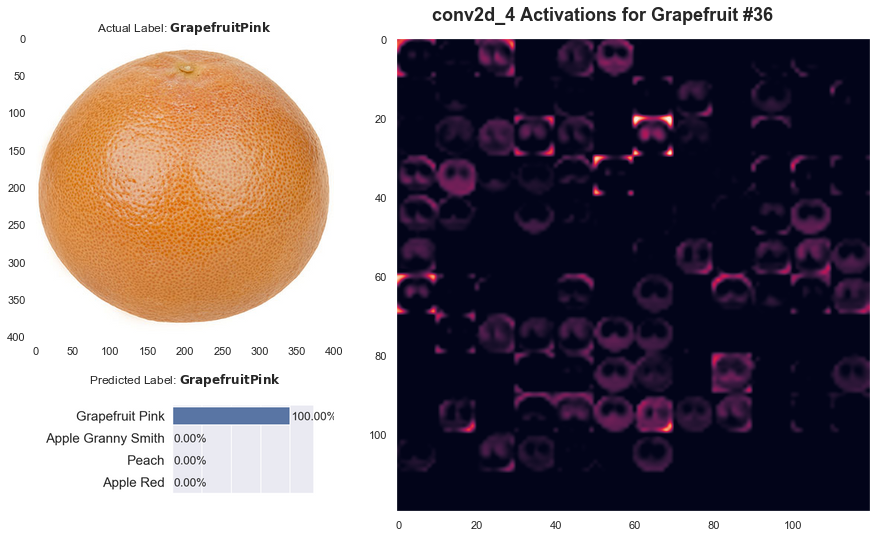

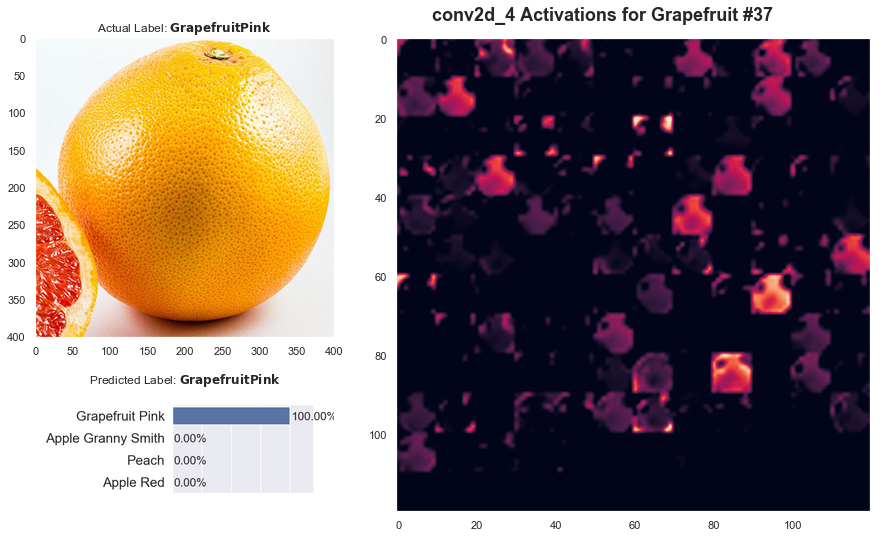

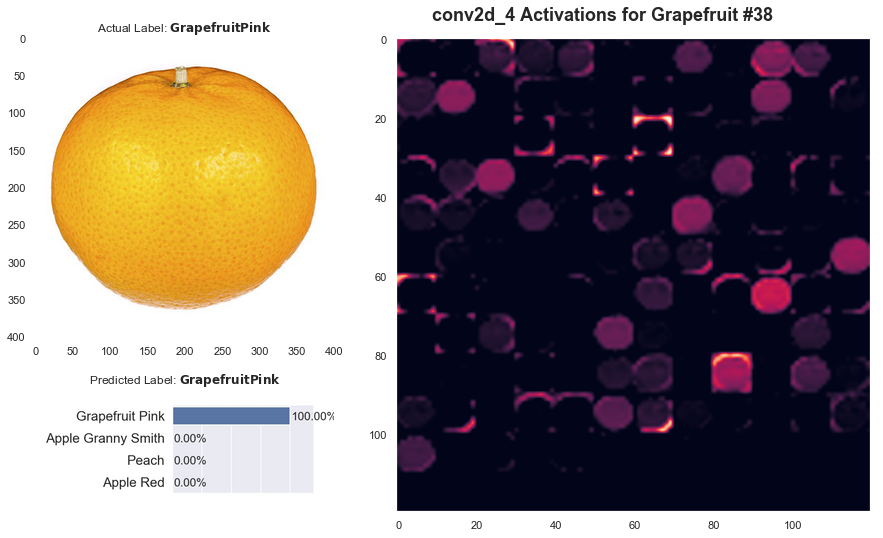

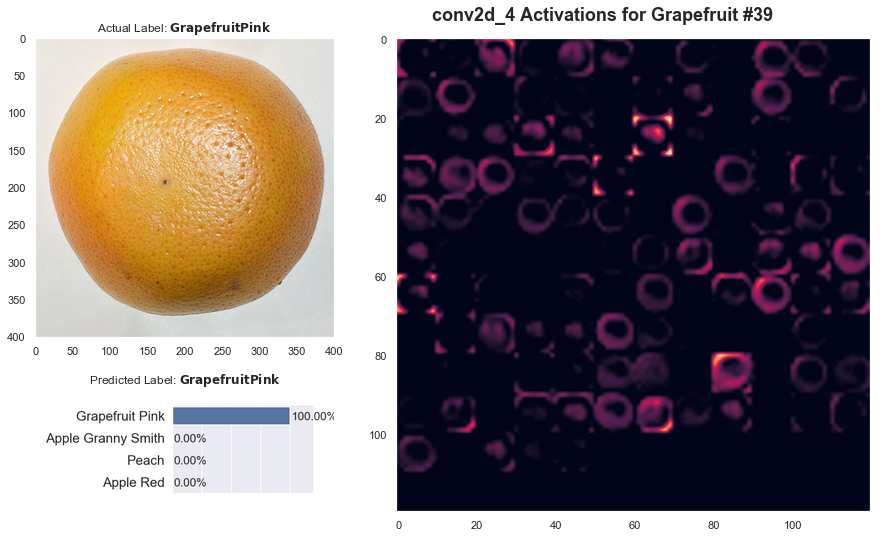

In [441]:
for target_layer in target_layers:
    for idx in grapefruit_TP_idxs:
        orig_img = X_val_orig[idx]
        viz_img = explainer.explain((np.array([X_val[idx]]), None),\
                                    cnn_fruits_mdl, target_layer)
        #viz_img = np.uint8(cm.jet(viz_img)[..., :3] * 255)
        y_true = y_val[idx,0]
        y_pred = y_val_pred[idx]
        probs_s = probs_df.loc[idx]
        title = '{} Activations for Grapefruit #{}'.format(target_layer, idx)
        mldatasets.compare_img_pred_viz(orig_img, viz_img, y_true,\
                                        y_pred, probs_s, title=title)

In [200]:
def model_modifier(mdl):
    global target_layer
    target = mdl.get_layer(name=target_layer)
    new_mdl = tf.keras.Model(inputs=mdl.inputs,\
                             outputs=target.output)
    new_mdl.layers[-1].activation = tf.keras.activations.linear
    return new_mdl

def loss(output):
    global filter_num
    return output[..., filter_num]

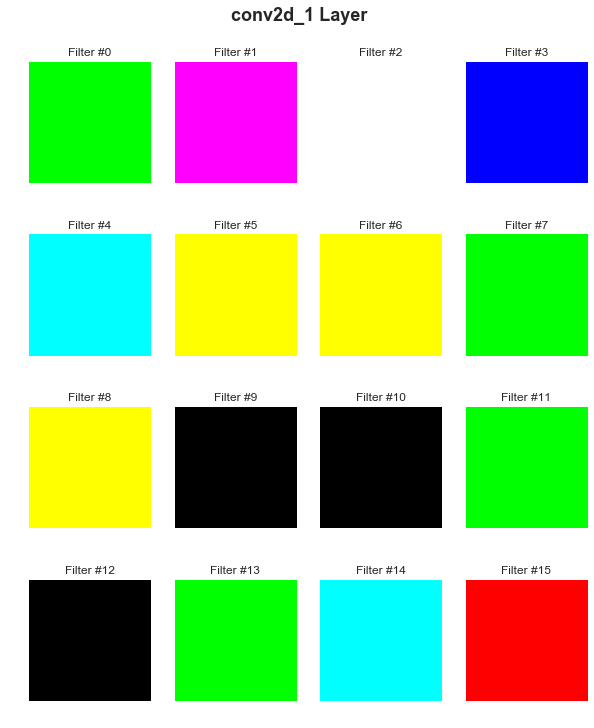

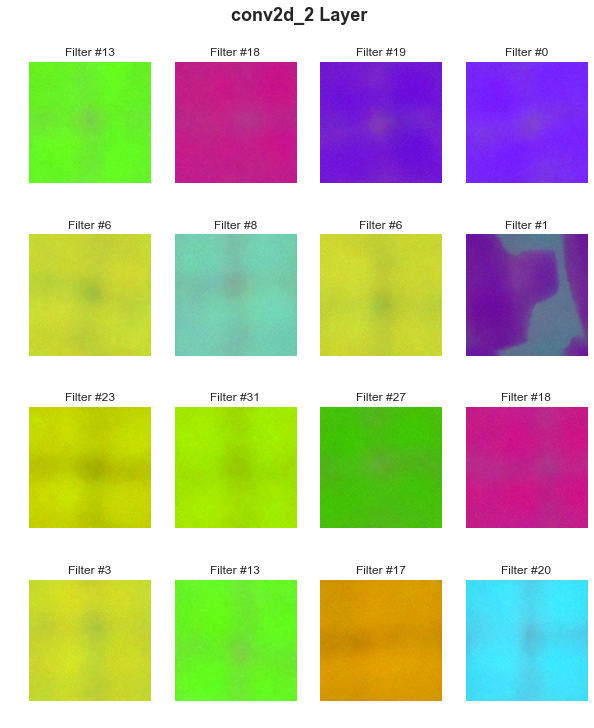

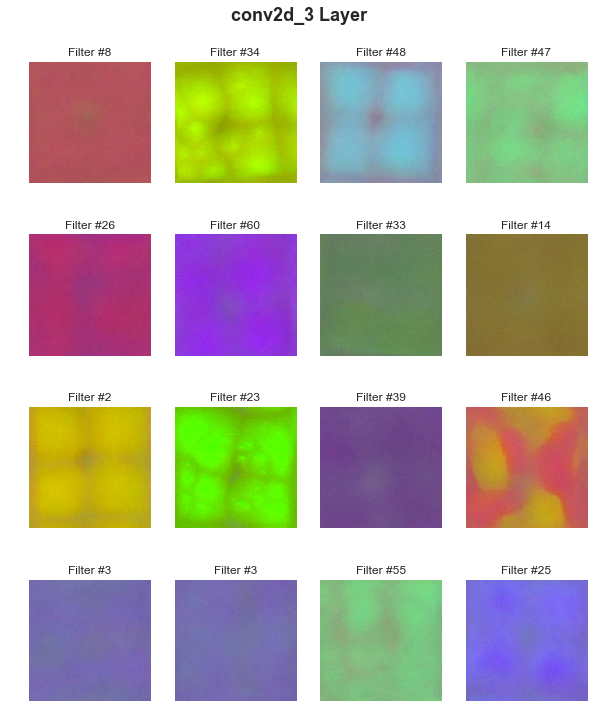

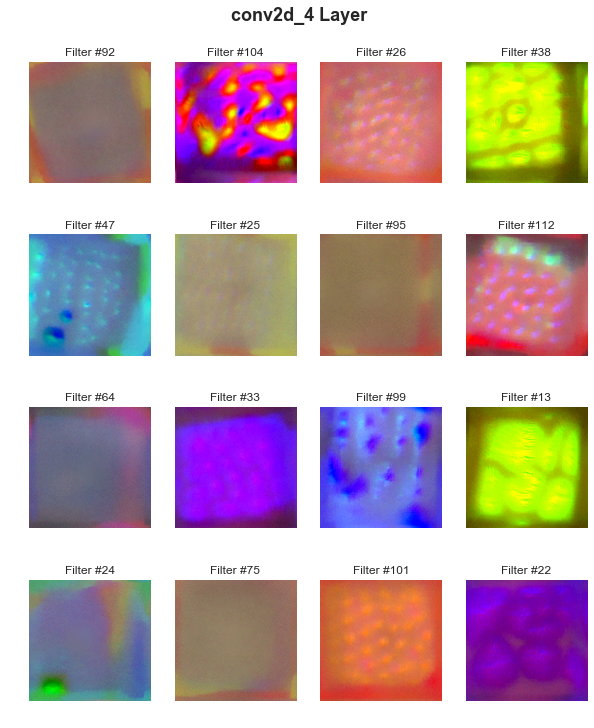

In [215]:
#How many filters to plot Activation Maximization for in each layer
num_filters = 16

#Compute size (width or height) of image size based on num_filters
gridsize = math.ceil(math.sqrt(num_filters))

#Iterate each target layer and..
for target_layer in target_layers:
    
    #Randomly select index of filters from total amount in layer
    for layer in cnn_fruits_mdl.layers:
        if layer.name == target_layer:
            total_filters = layer.filters
    if total_filters == num_filters or total_filters < num_filters:
        filter_num_l = [*range(num_filters)]
    else:
        filter_num_l = list(np.random.choice([*range(total_filters)],\
                                             num_filters))
    
    #Compute and Plot Activation Maximization for each random filter
    fig = plt.figure(figsize=(10,10))
    for f, filter_num in zip([*range(len(filter_num_l))], filter_num_l):
        plt.subplot(gridsize, gridsize, f+1)
        plt.title('Filter #{}'.format(filter_num), fontsize=12)
        activation_maximization = ActivationMaximization(cnn_fruits_mdl,\
                                            model_modifier, clone=True)
        activation = activation_maximization(loss)
        plt.imshow(activation[0].astype(np.uint8), interpolation='spline16')
        plt.axis("off")

    fig.suptitle('{} Layer'.format(target_layer), fontsize=18, weight='bold')
    plt.subplots_adjust(bottom=0, top=0.92)
    plt.show()

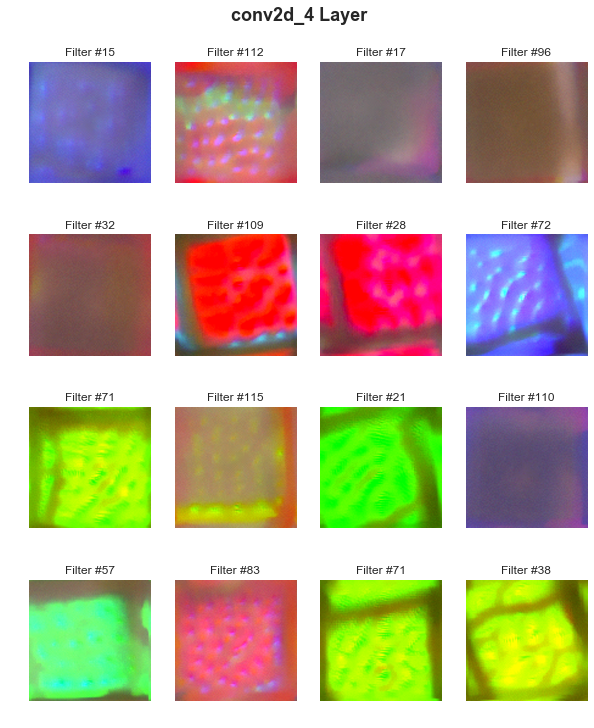

In [214]:
fig = plt.figure(figsize=(10,10))
for f, filter_num in zip([*range(len(filter_num_l))], filter_num_l):
    plt.subplot(gridsize, gridsize, f+1)
    plt.title('Filter #{}'.format(filter_num), fontsize=12)
    activation_maximization = ActivationMaximization(cnn_fruits_mdl,\
                                        model_modifier, clone=True)
    activation = activation_maximization(loss)
    plt.imshow(activation[0].astype(np.uint8), interpolation='spline16')
    plt.axis("off")
    
fig.suptitle('{} Layer'.format(target_layer), fontsize=18, weight='bold')
plt.subplots_adjust(bottom=0, top=0.92)
plt.show()

In [261]:
idxs = avocado_FN_idxs + grapefruit_FP_idxs
X_misclass = X_val[idxs]
print(X_misclass.shape)

(17, 100, 100, 3)


In [264]:
enc = preprocessing.OrdinalEncoder()
enc.fit(y_train)
y_val_pred_exp = np.expand_dims(np.array(y_val_pred),axis=1)
y_val_pred_enc = enc.transform(y_val_pred_exp)
labels_l = y_val_pred_enc[idxs].squeeze().\
                                    astype(int).tolist()
print(labels_l)

[9, 4, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6]


In [267]:
def model_modifier(mdl):
    mdl.layers[-1].activation = tf.keras.activations.linear
    return mdl

def loss(output):
    global labels_l
    pos_l = [*range(len(labels_l))]
    output_l = []
    for p, l in zip(pos_l, labels_l):
        output_l.append(output[p][l])
    return tuple(output_l)

In [278]:
saliency = Saliency(cnn_fruits_mdl,
                    model_modifier=model_modifier,
                    clone=True)

saliency_maps = saliency(loss, X_misclass)
saliency_maps = normalize(saliency_maps)

smoothgrad_saliency_maps = saliency(loss, X_misclass,\
                                smooth_samples=20,
                                smooth_noise=0.20)
smoothgrad_saliency_maps =\
                    normalize(smoothgrad_saliency_maps)

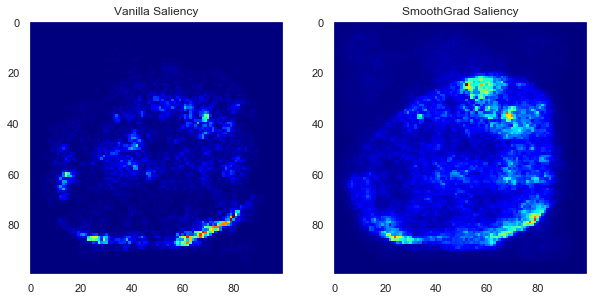

In [320]:
plt.subplots(figsize=(10,5))
plt.subplot(1, 2, 1)
plt.imshow(saliency_maps[0], cmap='jet')
plt.grid(b=None)
plt.title("Vanilla Saliency")
plt.subplot(1, 2, 2)
plt.imshow(smoothgrad_saliency_maps[0], cmap='jet')
plt.grid(b=None)
plt.title("SmoothGrad Saliency")
plt.show()

In [326]:
gradcam = GradcamPlusPlus(cnn_fruits_mdl,\
                          model_modifier=model_modifier,\
                          clone=True)

gradcam_maps = gradcam(loss, X_misclass,\
                       penultimate_layer=-1)
gradcam_maps = normalize(gradcam_maps)

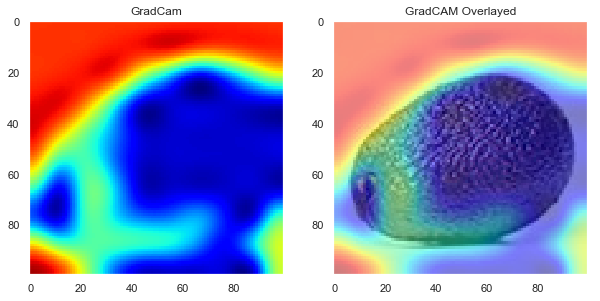

In [396]:
plt.subplots(figsize=(10,5))
plt.subplot(1, 2, 1)
heatmap = np.uint8(cm.jet(gradcam_maps[0])[..., :3] * 255)
plt.imshow(heatmap)
plt.grid(b=None)
plt.title("GradCam")
plt.subplot(1, 2, 2)
plt.imshow(X_misclass[0])
plt.imshow(heatmap, alpha=0.5)
plt.grid(b=None)
plt.title("GradCAM Overlayed")
plt.show()

In [349]:
explainer = IntegratedGradients()

ig_maps = []
for i in range(len(labels_l)):
    img = ([X_misclass[i]], None)
    label = labels_l[i]
    ig_map = explainer.explain(img, cnn_fruits_mdl,\
                               label, n_steps=25)
    ig_maps.append(ig_map)

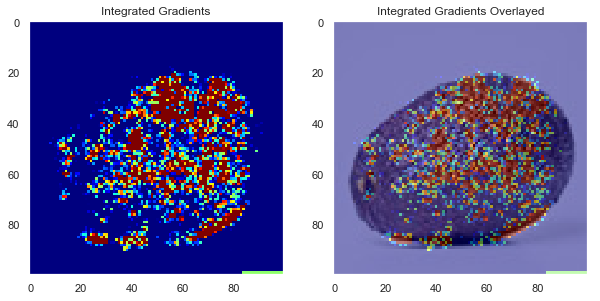

In [395]:
plt.subplots(figsize=(10,5))
plt.subplot(1, 2, 1)
heatmap = np.uint8(cm.jet(ig_maps[0])[..., :3] * 255)
plt.imshow(heatmap)
plt.grid(b=None)
plt.title("Integrated Gradients")
plt.subplot(1, 2, 2)
plt.imshow(X_misclass[0])
plt.imshow(heatmap, alpha=0.5)
plt.grid(b=None)
plt.title("Integrated Gradients Overlayed")
plt.show()

In [419]:
def heatmap_overlay(bg_img, overlay_img, cmap='jet'):
    img = np.uint8(bg_img[..., :3] * 255)
    if len(overlay_img.shape) == 2:
        overlay_img = cm.get_cmap(cmap)(overlay_img)
    heatmap = np.uint8(overlay_img[..., :3] * 255)
    return cv2.addWeighted(img, 0.5, heatmap, 0.5, 0)

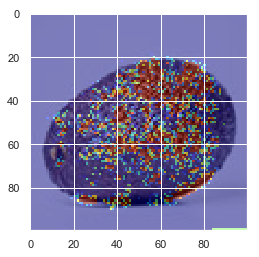

In [420]:
plt.imshow(heatmap_overlay(X_misclass[0], ig_maps[0]))

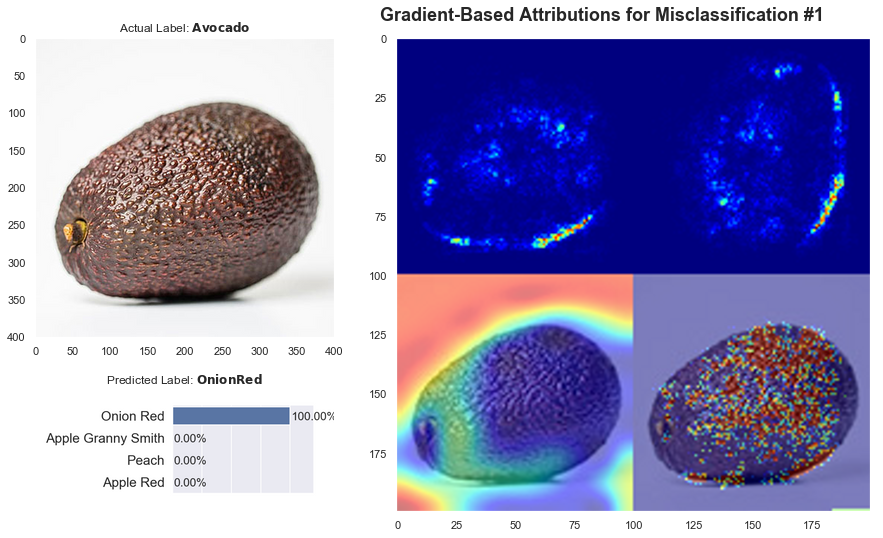

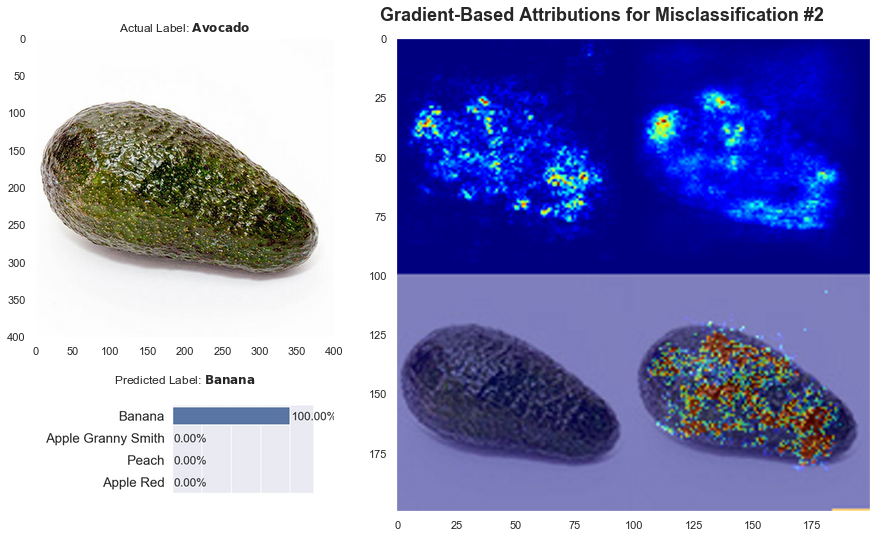

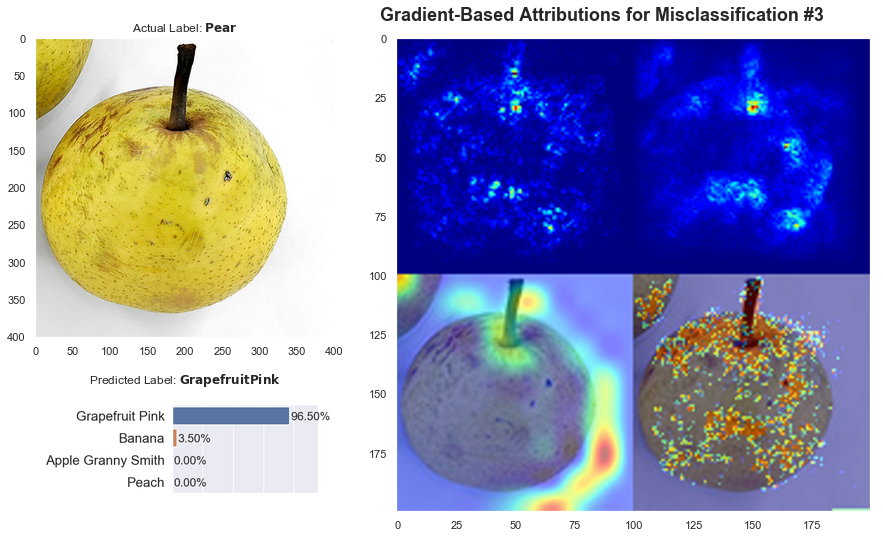

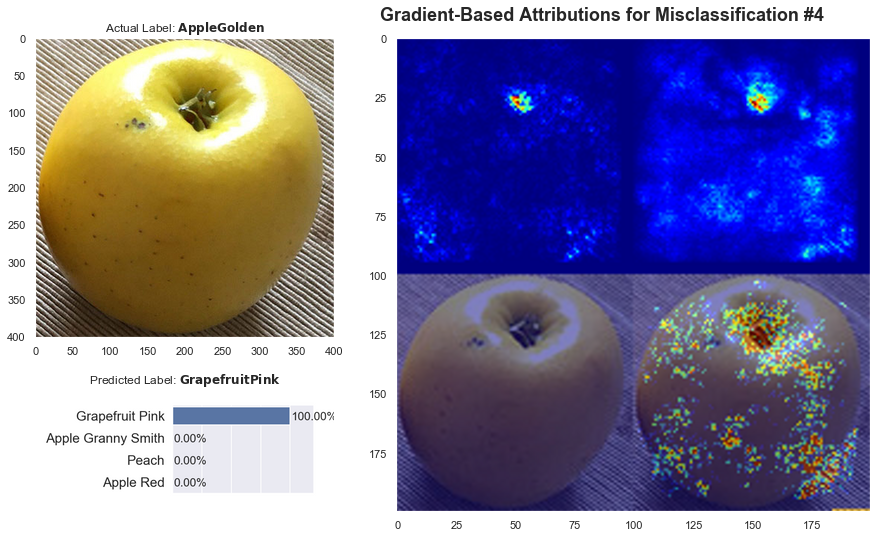

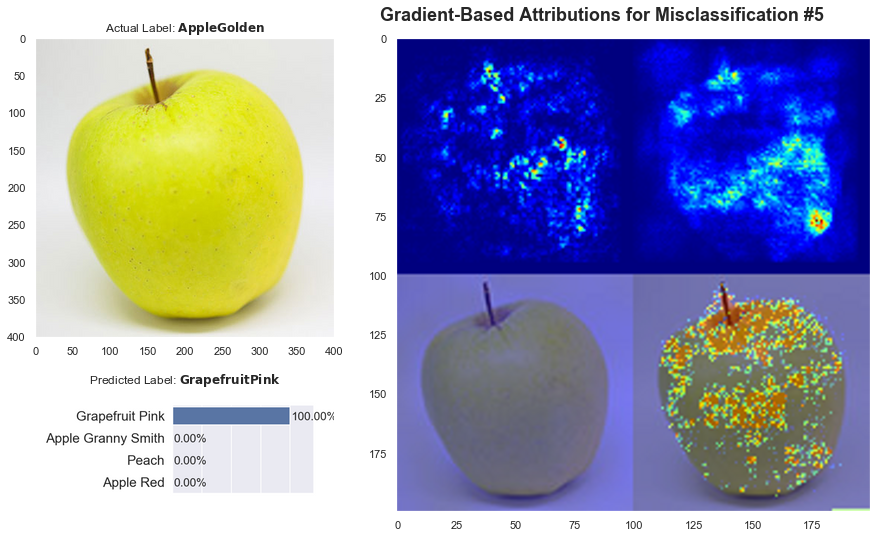

...

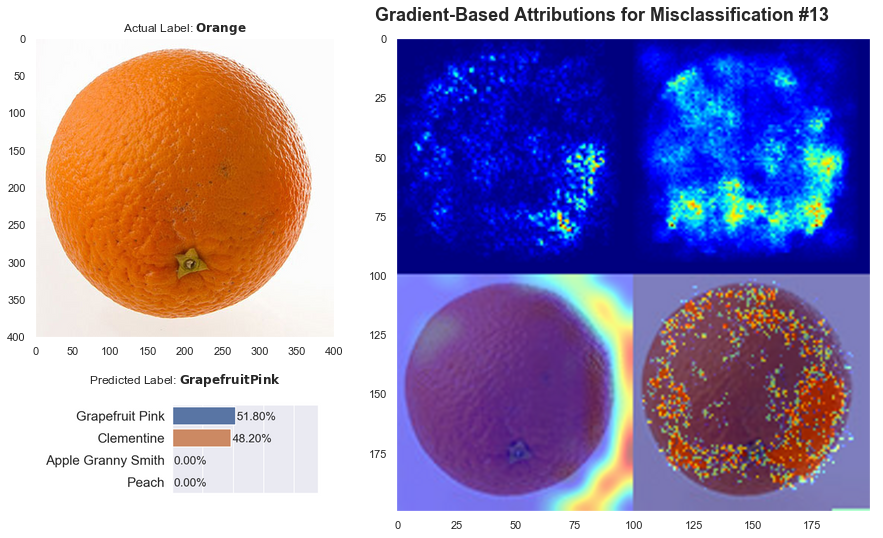

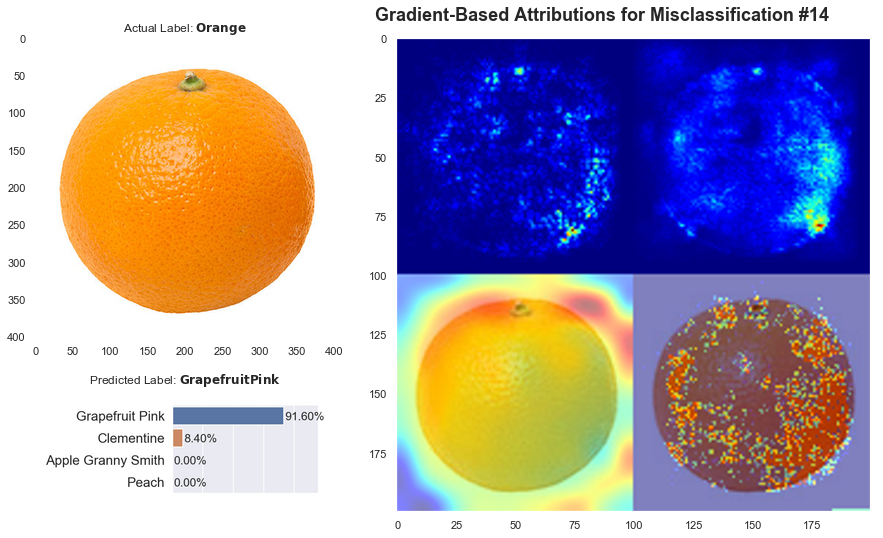

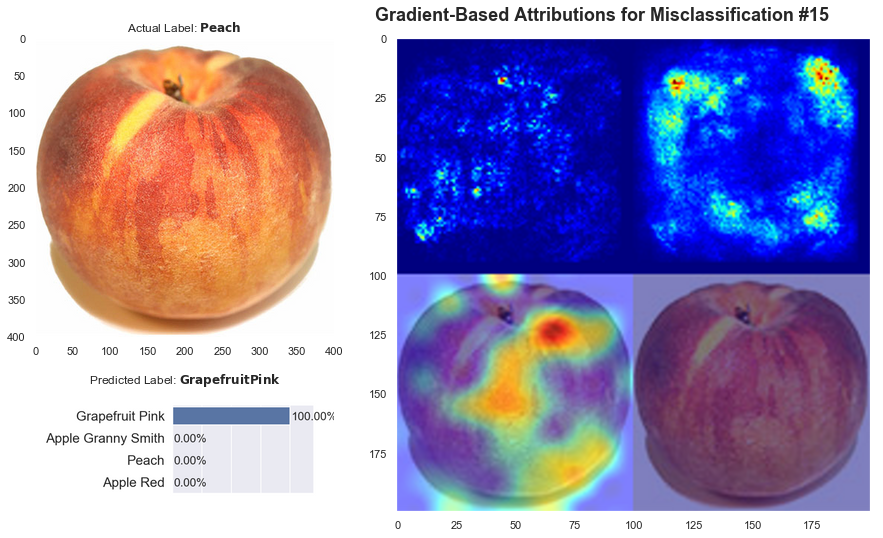

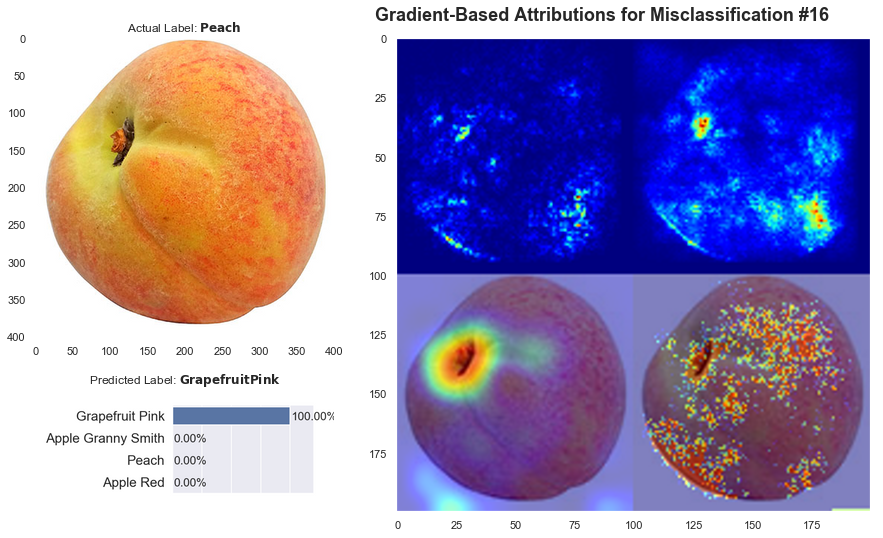

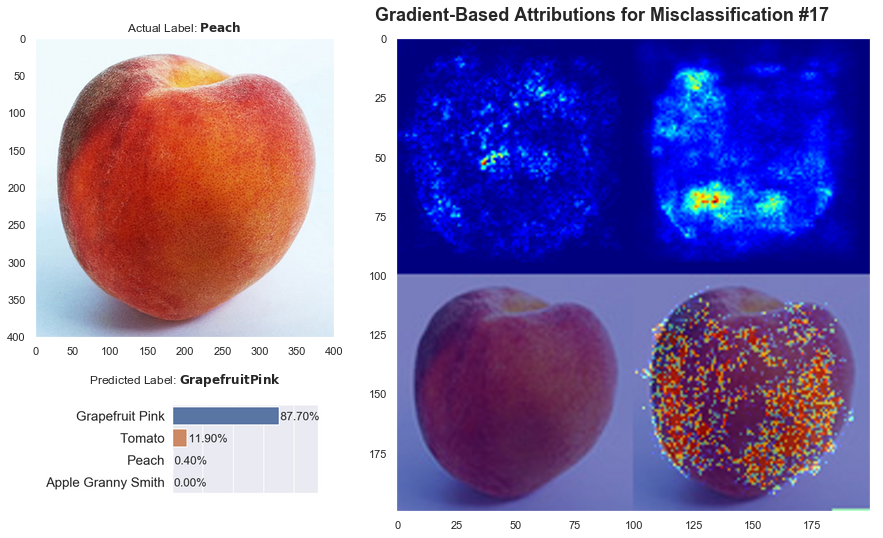

In [436]:
for pos, idx in zip([*range(len(idxs))], idxs):
    orig_img = X_val_orig[idx]
    map1 = np.uint8(cm.jet(saliency_maps[pos])[..., :3] * 255)
    map2 = np.uint8(cm.jet(smoothgrad_saliency_maps[pos])[..., :3] * 255)
    map3 = heatmap_overlay(X_misclass[pos], gradcam_maps[pos])
    map4 = heatmap_overlay(X_misclass[pos], ig_maps[pos])
    viz_img = cv2.vconcat([
            cv2.hconcat([map1, map2]),
            cv2.hconcat([map3, map4])
        ])
    y_true = y_val[idx,0]
    y_pred = y_val_pred[idx]
    probs_s = probs_df.loc[idx]
    title = 'Gradient-Based Attributions for Misclassification #{}'.format(pos+1)
    mldatasets.compare_img_pred_viz(orig_img, viz_img, y_true,\
                                    y_pred, probs_s, title=title)